# Wildflower Project - Evaluation - season2 (FINAL)

Test and evaluation with the refined dataset. FINAL version compares the following two models which are trained with the same random seed.

I will test: 
 - **Model A:** season 2 classifier (transfer learning with fine tune of all layers in Inception V3)
 - **Model B:** season 2 classifier3 5 blocks (fine tune with the last 5 Inception modules in Inception V3)

In [1]:
import os

SEED_VALUE = 47
os.environ['PYTHONHASHSEED']=str(SEED_VALUE)

import random
random.seed(SEED_VALUE)

import numpy as np
np.random.seed(SEED_VALUE)

import tensorflow as tf
tf.random.set_seed(SEED_VALUE)

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"] = ""

In [2]:
%matplotlib notebook

import os
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model

import matplotlib.pyplot as plt
import numpy as np
import random
from numpy.random import default_rng

np.set_printoptions(suppress=True) # Avoid scientific notation (1.500e-4)

print('TensorFlow version:', tf.__version__)

TensorFlow version: 2.2.0


In [3]:
tf.config.list_physical_devices('GPU')

[]

In [4]:
tf.config.list_physical_devices('CPU')

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]

## Check the number of Test Data

In [5]:
image_dir = "wf_data2"
test_dir = os.path.join(image_dir, "test")
print(test_dir)

test_classnum = len(os.listdir(test_dir))
print("Number of classes = {}".format(len(os.listdir(test_dir))))

test_samples = 0
for c in os.listdir(test_dir):
    test_samples += len(os.listdir(os.path.join(test_dir, c)))

print("Number of test samples = {}".format(test_samples))

wf_data2/test
Number of classes = 108
Number of test samples = 561


## Model A ( Fine tuning for all layers)

In [6]:
model_a_file = "wfmodel_s2_ft_final.h5"
model_a = load_model(model_a_file)

model_a.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
inception_v3 (Model)         (None, 5, 5, 2048)        21802784  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dropout (Dropout)            (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 512)               1049088   
_________________________________________________________________
dropout_1 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               131328

In [7]:
_BATCH_SIZE = 32

In [8]:
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=_BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

Found 561 images belonging to 108 classes.


In [9]:
class_names = np.array(list(test_generator.class_indices.keys()))
#print(class_names)

In [10]:
y_pred_a = model_a.predict(x=test_generator, steps=(test_samples // _BATCH_SIZE) + 1)
y_true = test_generator.classes

In [11]:
y_pred_a_idx = np.argmax(y_pred_a, axis=1)

In [12]:
print("Test samples that predicted correctly = {}".format(np.sum(y_pred_a_idx == y_true)))
print("Test Accuracy = {:.2f}%".format(np.sum(y_pred_a_idx == y_true) / test_samples * 100))

Test samples that predicted correctly = 424
Test Accuracy = 75.58%


## Model B ( Fine tuning for 5 inception blocks )

In [13]:
model_b_file = "wfmodel3_s2_5b_ft_final.h5"
model_b = load_model(model_b_file)

model_b.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
inception_v3 (Model)         (None, 5, 5, 2048)        21802784  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dropout (Dropout)            (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 512)               1049088   
_________________________________________________________________
dropout_1 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               131328

In [14]:
test_generator.reset()

In [15]:
y_pred_b = model_b.predict(x=test_generator, steps=(test_samples // _BATCH_SIZE) + 1)

In [16]:
y_pred_b_idx = np.argmax(y_pred_b, axis=1)

In [17]:
print("Test samples that predicted correctly = {}".format(np.sum(y_pred_b_idx == y_true)))
print("Test Accuracy = {:.2f}%".format(np.sum(y_pred_b_idx == y_true) / test_samples * 100))

Test samples that predicted correctly = 423
Test Accuracy = 75.40%


**Result:** **Model A** (full fine-tuned) scored the best test accuracy.

In [18]:
y_pred_idx = y_pred_a_idx
y_pred = y_pred_a

### Confusion Matrix

In [19]:
from sklearn.metrics import confusion_matrix

In [20]:
conf_mat = confusion_matrix(y_true, y_pred_idx)

In [21]:
conf_mat

array([[4, 0, 0, ..., 0, 0, 0],
       [0, 5, 0, ..., 0, 0, 0],
       [0, 0, 4, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 3, 0, 0],
       [0, 0, 0, ..., 0, 5, 0],
       [0, 0, 0, ..., 0, 0, 6]])

In [22]:
import seaborn as sns

fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(conf_mat, cmap='BuPu', ax=ax)
ax.set_xlabel('Predicted class')
ax.set_ylabel('True class')
plt.title('Confusion Matrix for the number of samples')
plt.show()

<IPython.core.display.Javascript object>

In [23]:
num_per_class = np.sum(conf_mat, axis=1)
#print(num_per_class)

norm_conf_mat = (conf_mat / num_per_class)

In [24]:
fig2, ax2 = plt.subplots(figsize=(10,10))
ax2 = sns.heatmap(norm_conf_mat, cmap='BuPu', ax=ax2)
ax2.set_xlabel('Predicted class')
ax2.set_ylabel('True class')
plt.title('Normarized Confusion Matrix for the number of samples')
plt.show()

<IPython.core.display.Javascript object>

## See which flowers are detected better or worse

In [25]:
masked_conf_mat = norm_conf_mat * np.eye(norm_conf_mat.shape[0])
recall_per_class = np.sum(masked_conf_mat, axis=1)
print(recall_per_class)

[0.8        0.83333333 0.8        0.8        0.66666667 0.8
 1.         1.         0.57142857 0.4        0.6        1.
 1.         0.8        0.2        1.         0.6        0.4
 0.85714286 0.6        0.8        0.33333333 0.4        0.6
 1.         0.8        0.6        0.8        0.75       0.8
 0.5        1.         1.         0.66666667 1.         0.6
 0.75       0.8        0.875      0.25       1.         0.8
 0.6        0.6        0.8        0.6        0.8        0.4
 0.83333333 1.         1.         0.2        0.6        1.
 0.5        0.66666667 0.4        0.8        1.         1.
 0.4        0.66666667 0.85714286 0.6        0.6        1.
 0.8        1.         1.         1.         0.83333333 0.6
 0.8        0.8        1.         0.66666667 1.         0.85714286
 1.         0.85714286 1.         0.875      0.8        0.6
 0.6        0.6        0.8        1.         0.66666667 0.
 0.5        0.5        1.         0.5        1.         1.
 0.33333333 0.66666667 1.         1.   

In [26]:
import matplotlib.gridspec as gridspec
%matplotlib inline

def plot_flowers(idx_array):

    _row = idx_array.shape[0]
    _col = 4

    #fig, ax = plt.subplots(_row, _col, figsize=(9, 20), constrained_layout=True)
    dpi = 80.
    height = (150 / dpi) * _row
    fig = plt.figure(figsize=(15, height))
    

    for i in range(_row):
        #ax[i, 0].text(0, 0.5, class_names[idx_array[i]])
        #ax[i, 0].set_xticks([])
        #ax[i, 0].set_yticks([])
        
        ax = fig.add_subplot(_row, _col, (i*4)+1)
        ax.axis('off')
        image_label = "{}: {}".format(idx_array[i], class_names[idx_array[i]])
        plt.text(0.5, 0.5, image_label, fontsize=12)
        
        class_path = os.path.join(test_dir, class_names[idx_array[i]])
        image_list = os.listdir(class_path)
        for j, image_file in enumerate(image_list[:3]):
            img = load_img(os.path.join(class_path, image_file))
            img = img.resize((150,150))
            img = img_to_array(img)
            img /= 255.
            #ax[i, 1+j].imshow(img)
            #ax[i, 1+j].set_xticks([])
            #ax[i, 1+j].set_yticks([])
            ax = fig.add_subplot(_row, _col, (i*4)+j+2)
            ax.axis('off')
            plt.imshow(img)
    
    plt.xticks([])
    plt.yticks([])
    
    fig.tight_layout(w_pad=5)
    plt.show()
    
    return fig

### Flowers more than 80% of which were detected correctly in test data 

Recall = (true positives / relevant images)

In [27]:
rec08 = np.squeeze(np.argwhere(recall_per_class >= 0.8))
print("Total {} flowers are detected correctly. (recall >= 0.8), {:.2f}% of the {} categories".format(rec08.shape[0], rec08.shape[0]/class_names.shape[0]*100, class_names.shape[0]))


Total 63 flowers are detected correctly. (recall >= 0.8), 58.33% of the 108 categories


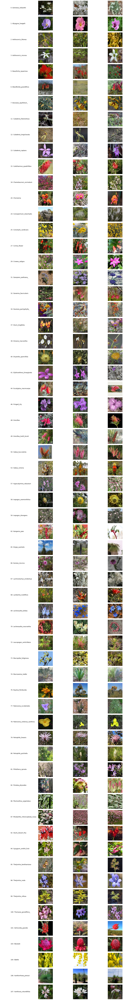

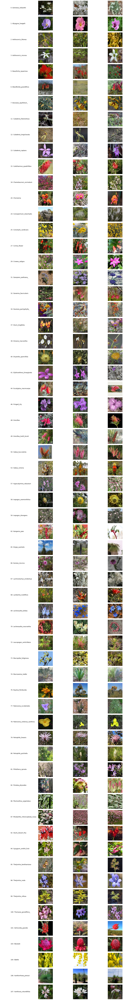

In [28]:
plot_flowers(rec08)

### Flowers less than 50% of which detected correctly in test data 

In [29]:
rec_less05 = np.squeeze(np.argwhere(np.sum(masked_conf_mat, axis=1) < 0.5))

In [30]:
print("Total {} flowers are detected incorrectly. (recall < 0.5), {:.2f}% of the {} categories".format(rec_less05.shape[0], rec_less05.shape[0]/class_names.shape[0]*100, class_names.shape[0]))

Total 12 flowers are detected incorrectly. (recall < 0.5), 11.11% of the 108 categories


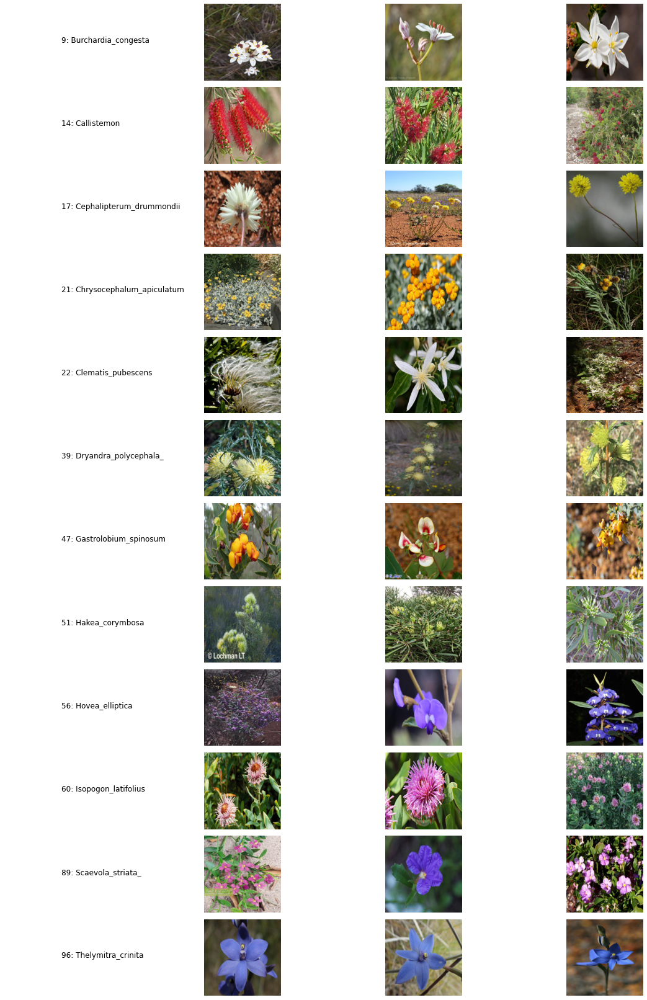

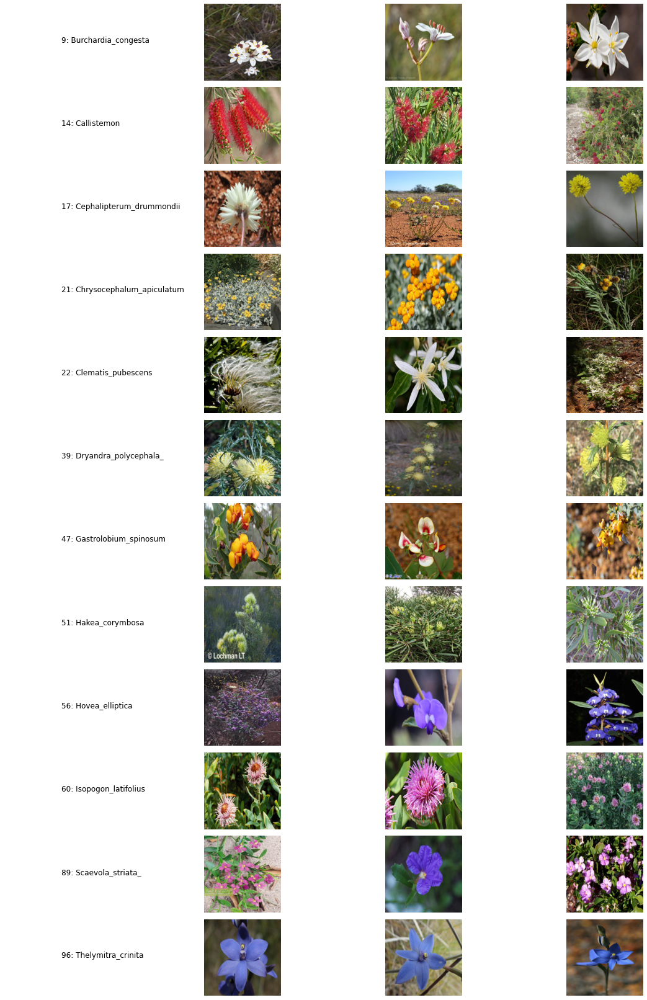

In [31]:
plot_flowers(rec_less05)

## Distribution of probability for classes (how much confidently the model detected the right class)

In [32]:
y_pred_correct = y_pred[np.arange(y_pred.shape[0]), y_true]
y_pred_correct /= np.sum(y_pred, axis=1) # probability

In [33]:
pred_prob_2D = [y_pred_correct[np.argwhere(y_true==i)] for i in np.arange(test_classnum)]

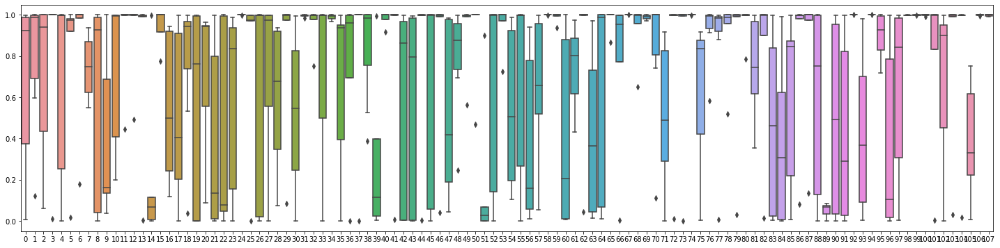

In [34]:
fig, ax = plt.subplots(figsize=(25, 6))

ax = sns.boxplot(data=pred_prob_2D, ax=ax)
plt.show()

In [35]:
pred_prob_2D_08 = []
for i in np.arange(test_classnum):
    if i in rec08:
        pred_prob_2D_08.append(pred_prob_2D[i])
        #print('{}: {} = {}'.format(i, class_names[i], pred_prob_2D[i]))

#print(pred_prob_2D_08)

### Distribution for classes with more than 80% of recall

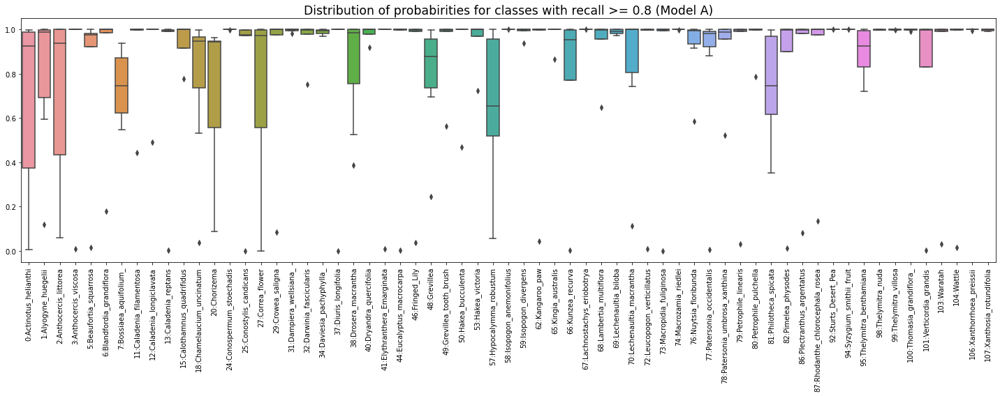

In [36]:
fig, ax = plt.subplots(figsize=(20, 8))

labels = ["{}:{}".format(i, class_names[i]) for i in rec08]
#print(labels)
#print(len(pred_prob_2D_08))
ax = sns.boxplot(data=pred_prob_2D_08, ax=ax)
ax.set_xticklabels(labels, rotation=90)
ax.set_title('Distribution of probabirities for classes with recall >= 0.8 (Model A)', fontsize="xx-large")
fig.tight_layout()
plt.show()

In [37]:
fig.savefig("dist_rec08_modelA.jpg")

### How the model mistakes? Confusion matrix about classes with recall < 0.5

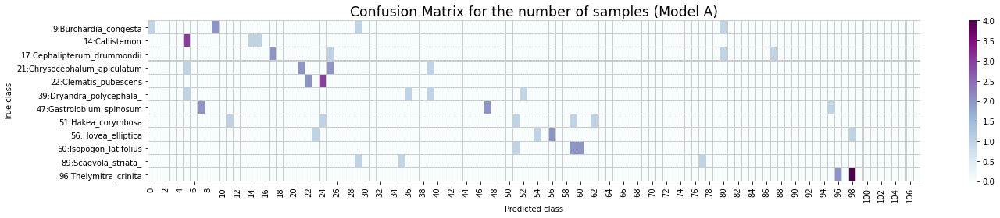

In [40]:
conf_mat_less = conf_mat[rec_less05]

fig, ax = plt.subplots(figsize=(20,4))
ax = sns.heatmap(conf_mat_less, cmap='BuPu', linewidths=.2, linecolor="#ccc", ax=ax)
ax.set_xlabel('Predicted class')
ax.set_ylabel('True class')
ylabels = ["{}:{}".format(i, class_names[i]) for i in rec_less05]
ax.set_yticklabels(ylabels, rotation=0)
plt.title('Confusion Matrix for the number of samples (Model A)', fontsize="xx-large")
fig.tight_layout()
plt.show()


In [41]:
fig.savefig("recall_05_confmat_modelA.jpg")

### Which flowers are recall >= 0.8 in both Model A and B ?

In [40]:
conf_mat_b = confusion_matrix(y_true, y_pred_b_idx)
num_per_class_b = np.sum(conf_mat_b, axis=1)
norm_conf_mat_b = (conf_mat_b / num_per_class_b)
masked_conf_mat_b = norm_conf_mat_b * np.eye(norm_conf_mat_b.shape[0])
recall_per_class_b = np.sum(masked_conf_mat_b, axis=1)
print(recall_per_class_b)

[0.8        0.5        0.6        1.         0.66666667 0.8
 1.         0.5        0.42857143 0.2        0.8        1.
 1.         0.8        0.6        0.8        0.8        0.2
 0.85714286 0.6        0.8        0.66666667 0.8        0.4
 0.8        0.6        0.6        0.6        0.75       0.8
 0.5        1.         1.         0.66666667 1.         0.8
 0.75       0.8        1.         1.         1.         1.
 0.4        0.8        0.8        0.6        0.8        0.6
 0.66666667 0.8        0.8        0.6        0.8        0.8
 0.66666667 0.83333333 0.4        0.4        1.         0.8
 0.4        1.         1.         0.6        0.6        0.8
 0.8        1.         1.         0.83333333 0.83333333 0.4
 0.8        0.6        1.         0.66666667 0.83333333 0.85714286
 0.4        0.85714286 1.         0.75       0.8        0.6
 0.8        0.6        0.8        0.8        0.66666667 1.
 0.66666667 0.33333333 1.         0.5        1.         0.66666667
 0.66666667 0.83333333 0.8333

In [41]:
rec08_b = np.squeeze(np.argwhere(recall_per_class_b >= 0.8))
print("Total {} flowers are detected correctly. (recall >= 0.8), {:.2f}% of the {} categories".format(rec08_b.shape[0], rec08_b.shape[0]/class_names.shape[0]*100, class_names.shape[0]))

Total 65 flowers are detected correctly. (recall >= 0.8), 60.19% of the 108 categories


In [42]:
rec08_b

array([  0,   3,   5,   6,  10,  11,  12,  13,  15,  16,  18,  20,  22,
        24,  29,  31,  32,  34,  35,  37,  38,  39,  40,  41,  43,  44,
        46,  49,  50,  52,  53,  55,  58,  59,  61,  62,  65,  66,  67,
        68,  69,  70,  72,  74,  76,  77,  79,  80,  82,  84,  86,  87,
        89,  92,  94,  97,  98,  99, 100, 101, 102, 103, 104, 105, 106])

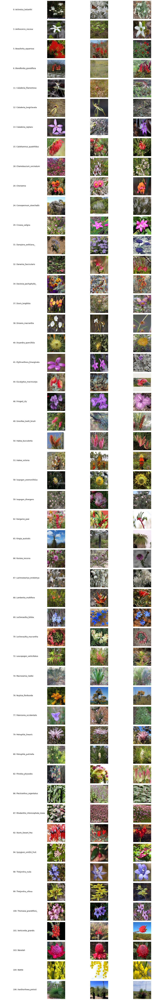

In [43]:
both_rec08 = np.intersect1d(rec08, rec08_b)
fig = plot_flowers(both_rec08)

In [44]:
fig.savefig("good_flowers_both.jpg")

In [45]:
print("Total {} flowers are detected correctly (recall >= 0.8) in both models, {:.2f}% of the {} categories".format(both_rec08.shape[0], both_rec08.shape[0]/class_names.shape[0]*100, class_names.shape[0]))

Total 51 flowers are detected correctly (recall >= 0.8) in both models, 47.22% of the 108 categories


**NOTE:**

See `wildflower_evaluation-season2-final-ModelB.ipynb` for the analysis of Model B.

Model A was slightly better in terms of test accuracy than Model B. However, when I analysed further, I discovered the differences between two models which was more than just "model A is better than B".

When I noticed "recall" for each class, model B has more classes (+2) which are over 0.8 recall rate.
Also, Model A has more classes that were not detected well (recall < 0.5), even though it is just one difference (Model A = 12 vs Model B = 11). In the confusion matrix for those classes, Model B detects more images as the supposed class than other classes(i.e. detects images in class X as class X mostly, not as other classes). Only 3 classes are not that case(9, 17, 57).
On the other hand, in 8 classes, Model A classifies images into invalid classes more than or equal to the number of images classified into the valid class (14, 21, 39, 47, 51, 60, 89, 96). In two cases, the model sorts more images into invalid classes than the correct class. 

As a tendency I can see from the visualisation, Model A detects correct classes with very high or perfect probabilities when they are confident, otherwise dismisses. Model B classifies images with the probabilities that have a range with variance.

The classes both models couldn't perform well were: 9, 17, 56, and 60. However, not all of the classes those two models don't perform well match. 


The classes the model is bad at detecting are also completely different between these two models. I think they are doing this classification task in a quite different way.

